# DECO

### Packages

In [1]:
import torch
import os
import sys
import numpy as np
import cv2
from loguru import logger
from PIL import Image
import json
import pandas as pd
import matplotlib.pyplot as plt

import trimesh

deco_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
sys.path.append(deco_dir)



# Monkey-patch deprecated attributes for chumpy
np.bool = bool
np.int = int
np.float = float
np.complex = complex
np.object = object
np.str = str
np.unicode = str

from models.deco import DECO

os.environ['PYOPENGL_PLATFORM'] = 'egl'

if torch.cuda.is_available():
    DEVICE = torch.device('cuda')
else:
    DEVICE = torch.device('cpu')
print("Running on:", DEVICE)

ckpt_path = os.path.join(deco_dir, 'checkpoints', 'Release_Checkpoint', 'deco_best.pth')
MODEL_PATH = ckpt_path

Running on: cpu


# Count DAMON class balance

DAMON: 4375/4384 images contain at least 1 contact pixel. 0.21% of the images have less than 1 contact pixel
RICH: 19414/19451 images contain at least 1 contact pixel. 0.19% of the images have less than 1 contact pixel
PROX: 40498/43137 images contain at least 1 contact pixel. 6.12% of the images have less than 1 contact pixel


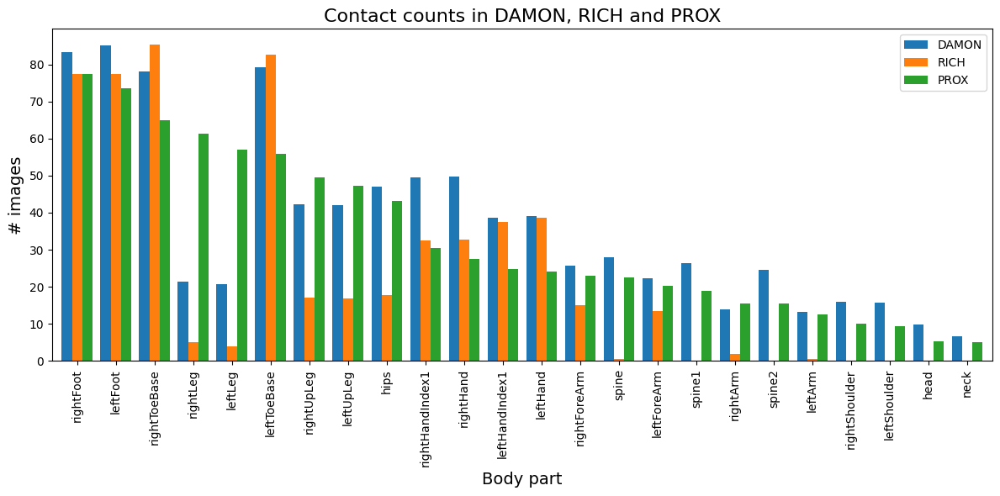

In [2]:

damon = np.load('../datasets/Release_Datasets/damon/hot_dca_trainval.npz')
rich = np.load('../datasets/Release_Datasets/rich/rich_train_smplx_cropped_bmp.npz')
prox = np.load('../datasets/Release_Datasets/prox/prox_train_smplx_ds4.npz')
vert_list = '../data/smpl_vert_segmentation.json'


def what_contact(data, vert_list, name, threshold=1):
    data = data['contact_label']
    with open(vert_list) as f:          # or just assign the dict literal
        part_vertices = json.load(f) 
    n_images = len(data)
    
    n_any_contact = (data.sum(axis=1) >= threshold).sum()
    percentage = ((n_images-n_any_contact)/n_images)*100
    print(f"{name}: {n_any_contact}/{n_images} images contain at least {threshold} contact pixel. {round(percentage, 2)}% of the images have less than {threshold} contact pixel")
    

    per_part_counts = {
    part: data[:, idxs].any(axis=1).sum()
    for part, idxs in part_vertices.items()
    }
    return n_any_contact, per_part_counts, n_images

damon_n_any_contact, damon_per_part_counts, damon_n_images = what_contact(damon, vert_list, "DAMON")
rich_n_any_contact, rich_per_part_counts, rich_n_images = what_contact(rich, vert_list, "RICH")
prox_n_any_contact, prox_per_part_counts, prox_n_images = what_contact(prox, vert_list, "PROX")

df = pd.DataFrame({
    "DAMON": pd.Series(damon_per_part_counts) / damon_n_images * 100,
    "RICH": pd.Series(rich_per_part_counts) / rich_n_images * 100,
    "PROX": pd.Series(prox_per_part_counts) / prox_n_images * 100,

}).fillna(0).round(1)

df = df.sort_values("PROX", ascending=False)# Sort by DAMON counts for consistent order
ax = df.plot(kind="bar", figsize=(12, 6), width=0.8)# Plot grouped bar chart

# font-size tweaks (as before) …
ax.set_title(f"Contact counts in DAMON, RICH and PROX", fontsize=16)
ax.set_xlabel("Body part", fontsize=14)
ax.set_ylabel("# images",  fontsize=14)


plt.tight_layout()
plt.show()

# Qualitative Analysis
### First test it yourself!

Before we show our own analysis of DECO, we would like you to play with the binary contact prediction output of the model. In the below cell, you can add path to an any image you would like to model to run on. It will output scene and body part masks of the image and contact prediction (in green) on the SMPL mesh. The output of the cell is a 3D window which allows you to interact with it; zoom in and out and move it in all possible direction.

In [3]:
def initiate_model(device):
    deco_model = DECO('hrnet', True, device)
    # deco_model = DECO('swin', True, device)

    logger.info(f'Loading weights from {MODEL_PATH}')
    print(device)


    checkpoint = torch.load(MODEL_PATH,  map_location=device, weights_only=False)
    deco_model.load_state_dict(checkpoint['deco'], strict=False)
    deco_model.eval()

    return deco_model

torch.cuda.empty_cache()
deco_model = initiate_model(DEVICE)

def visualize_body_mesh(cont, smpl_path="../data/smpl/smpl_neutral_tpose.ply", mesh_colour=[220, 220, 220, 255], annot_colour=[0, 255, 0, 255]):
    cont_smpl = []
    for indx, i in enumerate(cont):
        if i >= 0.5:
            cont_smpl.append(indx)

    contact_smpl = np.zeros((1, 1, 6890))
    contact_smpl[0][0][cont_smpl] = 1

    body_model_smpl = trimesh.load(smpl_path, process=False)
    for vert in range(body_model_smpl.visual.vertex_colors.shape[0]):
        body_model_smpl.visual.vertex_colors[vert] = mesh_colour
    body_model_smpl.visual.vertex_colors[cont_smpl] = annot_colour
    return body_model_smpl


def contact_prediction(img_src):

    # for img_name in images:
    img = cv2.imread(img_src)
    img = cv2.resize(img, (256, 256), cv2.INTER_CUBIC)
    img = img.transpose(2, 0, 1) / 255.0
    img = img[np.newaxis, :, :, :]
    img = torch.tensor(img, dtype=torch.float32).to(DEVICE)

    cont, scene_mask_pred, part_mask_pred, _ = deco_model(img)
    cont = cont.detach().cpu().numpy().squeeze()
    scene_mask_pred = scene_mask_pred.detach().cpu().numpy().squeeze()
    part_mask_pred = part_mask_pred.detach().cpu().numpy().squeeze()

    body_model_smpl = visualize_body_mesh(cont)


    # Process semantic mask
    scene_mask_max = np.argmax(scene_mask_pred, axis=0).astype(np.uint8)

    # Process part mask
    part_mask_max = np.argmax(part_mask_pred, axis=0).astype(np.uint8)

    return np.flipud(scene_mask_max), np.flipud(part_mask_max), body_model_smpl


2025-06-10 22:58:06.078 | INFO     | utils.hrnet:init_weights:525 - => init weights from normal distribution
2025-06-10 22:58:06.283 | WARNING  | utils.hrnet:init_weights:553 - IMPORTANT WARNING!! Please download pre-trained models if you are in TRAINING mode!
2025-06-10 22:58:06.351 | INFO     | utils.hrnet:init_weights:525 - => init weights from normal distribution
2025-06-10 22:58:06.552 | WARNING  | utils.hrnet:init_weights:553 - IMPORTANT WARNING!! Please download pre-trained models if you are in TRAINING mode!
2025-06-10 22:58:06.619 | INFO     | __main__:initiate_model:5 - Loading weights from /Users/fleurdolmans/Downloads/deco-main-2/checkpoints/Release_Checkpoint/deco_best.pth


cpu


In [4]:
def visualize_mask_with_rects(mask, title="Mask", class_names=None, num_classes=133):
    from bokeh.plotting import figure, show, output_notebook
    from bokeh.models import ColumnDataSource, HoverTool
    import numpy as np
    import matplotlib.pyplot as plt

    def get_color_map(num_classes):
        cmap = plt.get_cmap('nipy_spectral', num_classes)  # or 'gist_ncar', 'hsv'
        color_map = (cmap(np.arange(num_classes))[:, :3] * 255).astype(np.uint8)
        return color_map

    output_notebook()

    h, w = mask.shape
    flat_mask = mask.flatten()

    # Generate full color map once for all 133 labels
    color_map = get_color_map(num_classes)

    if flat_mask.max() >= num_classes:
        raise ValueError(f"Label {flat_mask.max()} exceeds expected number of classes ({num_classes})")

    # Assign colors
    colors = color_map[flat_mask]
    hex_colors = ["#%02x%02x%02x" % tuple(c) for c in colors]

    # Grid positions
    yy, xx = np.indices((h, w))
    source = ColumnDataSource(data=dict(
        x=xx.flatten(),
        y=yy.flatten(),
        class_id=flat_mask,
        color=hex_colors,
    ))

    if class_names:
        source.data['class_name'] = [class_names[i] if i < len(class_names) else f"Class {i}" for i in flat_mask]

    p = figure(title=title, tools="hover,pan,box_zoom,reset", width=256, height=256, match_aspect=True)
    p.rect('x', 'y', width=1, height=1, color='color', source=source, line_color=None)

    tooltips = [("x", "@x"), ("y", "@y"), ("class ID", "@class_id")]
    if class_names:
        tooltips.append(("class name", "@class_name"))

    p.select_one(HoverTool).tooltips = tooltips
    return p



def visualize_mask_with_rects_part(mask, title="Mask", class_names=None):
    from bokeh.plotting import figure, show, output_notebook
    from bokeh.models import ColumnDataSource, HoverTool
    import numpy as np

    output_notebook()

    h, w = mask.shape
    flat_mask = mask.flatten()

    COLOR_PALETTE_24 = [
        (31, 119, 180), (255, 127, 14), (44, 160, 44), (214, 39, 40),
        (148, 103, 189), (140, 86, 75), (227, 119, 194), (127, 127, 127),
        (188, 189, 34), (23, 190, 207), (174, 199, 232), (255, 187, 120),
        (152, 223, 138), (255, 152, 150), (197, 176, 213), (196, 156, 148),
        (247, 182, 210), (199, 199, 199), (219, 219, 141), (158, 218, 229),
        (57, 59, 121), (82, 84, 163), (107, 110, 207), (156, 158, 222)
    ]

    # Check for overflow
    if flat_mask.max() >= len(COLOR_PALETTE_24):
        raise ValueError(f"Mask label ID {flat_mask.max()} exceeds color palette size.")

    colors = [COLOR_PALETTE_24[i] for i in flat_mask]
    hex_colors = ["#%02x%02x%02x" % tuple(c) for c in colors]

    yy, xx = np.indices((h, w))
    source = ColumnDataSource(data=dict(
        x=xx.flatten(),
        y=yy.flatten(),
        class_id=flat_mask,
        color=hex_colors,
    ))

    if class_names:
        source.data['class_name'] = [class_names[i] if i < len(class_names) else f"Class {i}" for i in flat_mask]

    p = figure(title=title, tools="hover,pan,box_zoom,reset", width=256, height=256, match_aspect=True)
    p.rect('x', 'y', width=1, height=1, color='color', source=source, line_color=None)

    tooltips = [("x", "@x"), ("y", "@y"), ("class ID", "@class_id")]
    if class_names:
        tooltips.append(("class name", "@class_name"))

    p.select_one(HoverTool).tooltips = tooltips
    return p


In [5]:
# Get all labels
labels_path = os.path.join(os.getcwd(), 'labels', 'labels.txt')
smpl_labels_path = os.path.join(os.getcwd(), 'labels', 'smpl_labels.txt')
hot_labels_path = os.path.join(os.getcwd(), 'labels', 'hot_labels.txt')

with open(labels_path, "r") as f:
    class_names = [line.strip() for i, line in enumerate(f) if i < 133]

with open(smpl_labels_path, "r") as f:
    part_smpl_names = [line.strip() for i, line in enumerate(f) if i < 133]

with open(hot_labels_path, "r") as f:
    part_hot_names = [line.strip() for i, line in enumerate(f) if i < 133]

In [6]:
def visualize(img_src, scene_mask, part_mask):
    _, axes = plt.subplots(1, 3, figsize=(8, 4))

    img = plt.imread(img_src)
    axes[0].imshow(img)
    axes[0].set_title("Input image")
    axes[0].axis('off')

    axes[1].imshow(np.flipud(scene_mask), cmap='jet')
    axes[1].set_title("Scene mask")
    axes[1].axis('off')

    axes[2].imshow(np.flipud(part_mask), cmap='jet')
    axes[2].set_title("Part mask")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

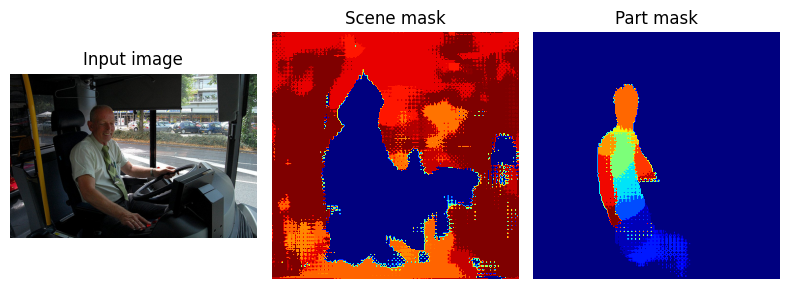

In [7]:
# Change img_src to the math to any image you would like to investigate. 
img_src = "images/occlusion3.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()

## Challenging scenario’s.
We compiled a dataset of 18 images from the DAMON testset divided featuring different challenging scenario’s: 
-  no foot contact
- soft materials and occlusions
- cropped bodies
- children. 

The images are past as input to DECO which predicts the binary contact on SMPL body meshes. Additionally, we visualize the predicted 
part and scene mask from the part and scene branches to get a better understanding on where the model fails. 

#### No foot contact

The most frequent error is systematic false-positive foot contact, even when the subject’s feet are clearly off the ground (e.g., during a jump or while lying down). The cell below show an example of this with a person jumping, However the model still predicts the feet and a small part of the fingers to are in contact. Hands and feet are often absent from the scene and part mask is almost all image like this one.

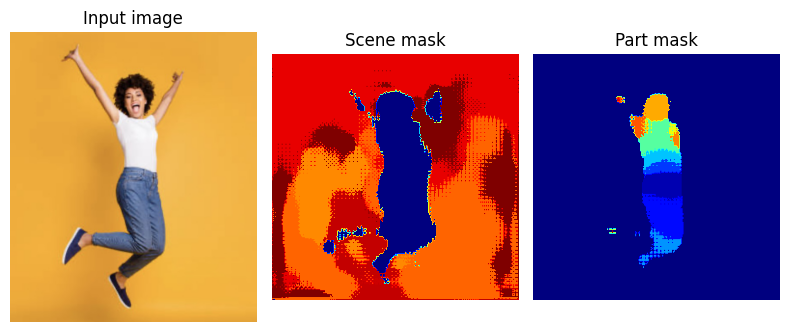

In [8]:
img_src = "images/jumping2.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()


#### Soft materials and occlusion

Soft surfaces (e.g., couches) and occlusions degrade predictions, with contact regions consistently underestimated. Additionally we see that laying poses tend to be hard in which the model something misses to predict more then half of the body. 

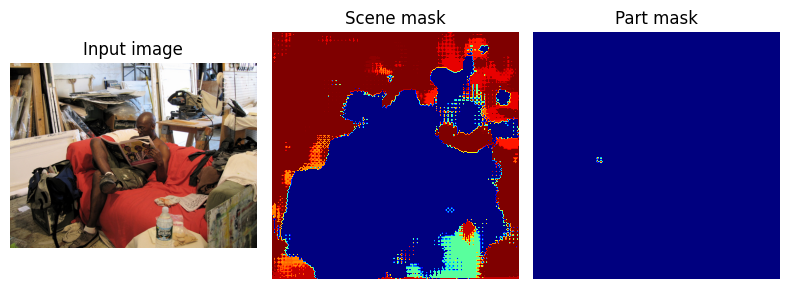

In [9]:
img_src = "images/soft_tissue1.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()

#### Cropped images

In contrast with the occlusion performances, DECO performance reasonably well on cropped images of seated or standing adults.

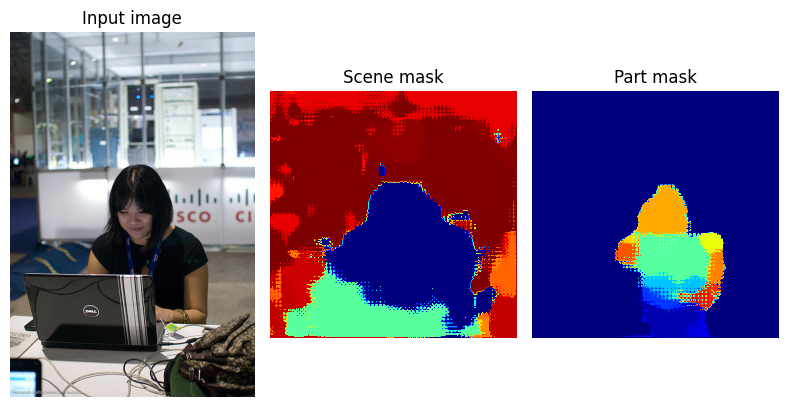

In [10]:
img_src = "images/cropped2.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()

#### Children

Performance drops for children; the model occasionally identifies hand- or foot-ground contacts but almost never flags contact by other body parts. When the child is for example also laying on a soft surface, the model fails; not finding any body parts (empty part mask) and predict almost no contact. 

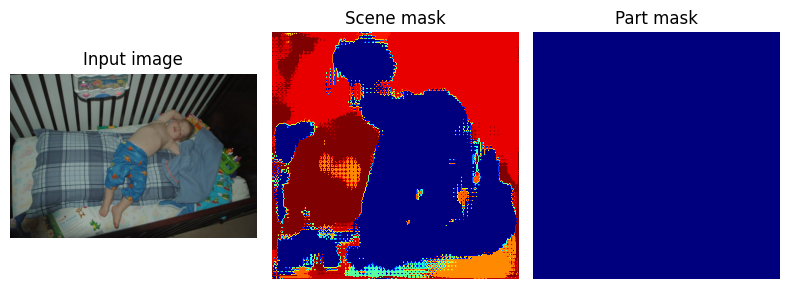

In [11]:
img_src = "images/child2.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()

## Scene and part segmentation.

Like seen in the previous visualization the model outputs uniformly weak segmentation from both branches.
Hands and feet are often absent from the part masks, and in several cases the network fails to detect the body at all. Scene masks are acceptable when the subject is standing and unobstructed; even then the outlines are coarse. Performance often drops for seated or recumbent poses, and the model sometimes labelling an entire sofa as person
The produced scene masks are acceptable when the subject is standing and unobstructed; even then the outlines are coarse. Performance often drops for seated or recumbent
poses, and the model sometimes labelling an entire sofa as person.

To investigate whether DECO has learned meaningful part concepts, we compared its part predictions on several DAMON-train images with their true ground-truth masks. The visualisations below show that the scene and part masks. You can move with you curser over the segemntations which shows you the label of the segemntation. (Note: the predicted part mask and true part mask have different labels so color and names may be different but they often represent the same body part.)

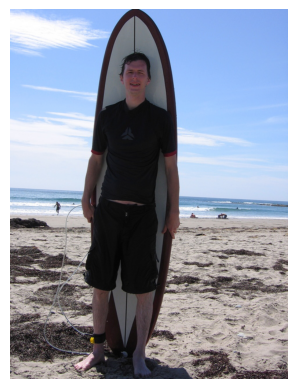

Loading BokehJS ...

Loading BokehJS ...

Loading BokehJS ...

Loading BokehJS ...

In [12]:
from bokeh.plotting import show, output_notebook
from bokeh.layouts import row

img_src = "../datasets/HOT-Annotated/images/hake_train2015_HICO_train2015_00013538.jpg"
part_mask_src = '../datasets/HOT-Annotated/segments/hake_train2015_HICO_train2015_00013538.png'
scene_mask_src = '../datasets/HOT-Annotated/segmentation_masks/training/hake_train2015_HICO_train2015_00013538.png'


dataset_part_mask = Image.open(part_mask_src)
dataset_part_mask = np.flipud(np.array(dataset_part_mask))

dataset_scene_mask = Image.open(scene_mask_src)
dataset_scene_mask = np.flipud(np.array(dataset_scene_mask))

scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)

img = plt.imread(img_src)
plt.imshow(img)
plt.axis('off')
plt.grid(False)
plt.show()

scene_pred_plot = visualize_mask_with_rects(scene_mask, "Predicted scene mask", class_names)
scene_gt_plot = visualize_mask_with_rects(dataset_scene_mask, "True scene mask", class_names)
part_pred_plot = visualize_mask_with_rects_part(part_mask, "Predicted part mask", part_smpl_names)
part_gt_plot = visualize_mask_with_rects_part(dataset_part_mask, "True part mask", part_hot_names)

# Show all plots in one row
show(row(scene_pred_plot, scene_gt_plot, part_pred_plot, part_gt_plot))


#### Scenic image without people.

We exampled what the model would do when there is no person in the image. Even though the part encoder does not detect any human parts, deco still predicts contact on the feet.

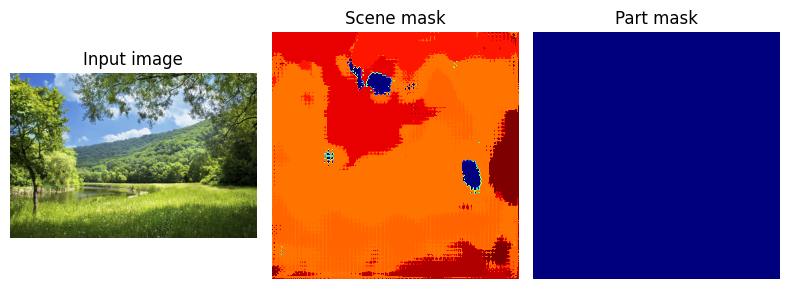

In [15]:
img_src = "images/landscape.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()

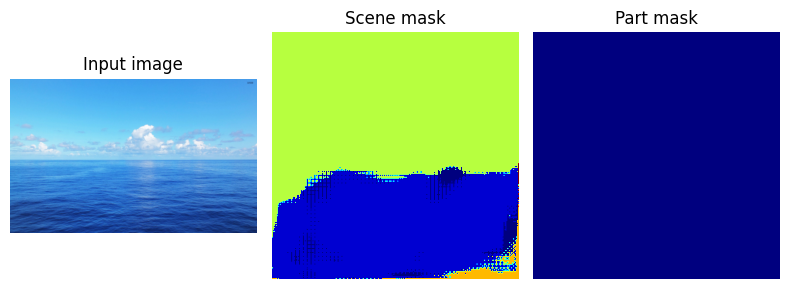

In [16]:
img_src = "images/sea.jpg"

# Visualize input image, scene and part mask and binary contact prediction on SMPL mesh
scene_mask, part_mask, body_model_smpl = contact_prediction(img_src)
visualize(img_src, scene_mask, part_mask)
body_model_smpl.show()